# Cartoonize with StyleGAN2

> ✔ In this notebook, ~~

- Author : [Tackhyun Jung](https://github.com/takhyun12)
- Reference : [Jihye Back](https://github.com/happy-jihye/Cartoon-StyleGAN)

## 1. github 및 관련 라이브러리 다운로드

In [1]:
!git clone https://github.com/happy-jihye/Cartoon-StyleGan2.git


import os
os.chdir(f'./Cartoon-StyleGan2')

!pip install ftfy regex tqdm ninja gdown
!pip install git+https://github.com/openai/CLIP.git

Cloning into 'Cartoon-StyleGan2'...
remote: Enumerating objects: 159, done.
remote: Counting objects: 100% (49/49), done.
remote: Compressing objects: 100% (38/38), done.
remote: Total 159 (delta 21), reused 30 (delta 11), pack-reused 110
Receiving objects: 100% (159/159), 128.89 MiB | 25.38 MiB/s, done.
Resolving deltas: 100% (37/37), done.
     |████████████████████████████████| 64 kB 2.0 MB/s 
     |████████████████████████████████| 108 kB 18.7 MB/s 
  Created wheel for ftfy: filename=ftfy-6.0.3-py3-none-any.whl size=41933 sha256=c2f151188fbb25f1d9cf6487211041963e53ae75a88dba67dbe61fa327a254e2
  Stored in directory: /root/.cache/pip/wheels/19/f5/38/273eb3b5e76dfd850619312f693716ac4518b498f5ffb6f56d
Successfully built ftfy
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-x8a_k7qe
  Running command git clone -q https://github.com/openai/CLIP.git /tmp/pip-req-build-x8a_k7qe
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369090 sha256=7ef4ca7a1ef092

## 2. pre-trained model 다운로드
> ✔ 구글 드라이브에서 colab 환경으로 압축파일을 복사하여 압축해지 하는 방식으로 진행됩니다

In [2]:
from google.colab import drive
drive.mount('/content/drive')

!mkdir /content/Cartoon-StyleGan2/networks
!cp /content/drive/MyDrive/dataset/pre-trained-model/cartoon/cartoon.zip /content/Cartoon-StyleGan2/networks/cartoon.zip

!unzip /content/Cartoon-StyleGan2/networks/cartoon.zip -d /content/Cartoon-StyleGan2/networks

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.activity.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fexperimentsandconfigs%20https%3a%2f%2fwww.googleapis.com%2fauth%2fphotos.native&response_type=code

Enter your authorization code:
4/1AX4XfWhKH59LaNcQkn0uitO3zll2zun3OG733lQJ8hcw7UUGDnRgS2vxOro
Mounted at /content/drive
Archive:  /content/Cartoon-StyleGan2/networks/cartoon.zip
  inflating: /content/Cartoon-StyleGan2/networks/Disney.pt  
  inflating: /content/Cartoon-StyleGan2/networks/Disney_FreezeSG.pt  
  inflating: /content/Cartoon-S

> ✔ 가볍게 ffhq256와 enchoder_ffhq만 다운로드 받기

In [10]:
from google.colab import drive
drive.mount('/content/drive')

!mkdir /content/Cartoon-StyleGan2/networks
!cp /content/drive/MyDrive/dataset/pre-trained-model/cartoon/ffhq256.pt /content/Cartoon-StyleGan2/networks/ffhq256.pt
!cp /content/drive/MyDrive/dataset/pre-trained-model/cartoon/encoder_ffhq.pt /content/Cartoon-StyleGan2/networks/encoder_ffhq.pt

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
mkdir: cannot create directory ‘/content/Cartoon-StyleGan2/networks’: File exists


## 3-1 StyleGANv2 기반의 이미지 생성
> ✔ pre-trained model을 torch.load를 통해 생성모델로 불러와 정의합니다.

In [14]:
import torch
import cv2 
import numpy as np
from torchvision.utils import save_image, make_grid
import PIL.Image as pilimg
from model import Generator


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
n_sample = 5
truncation = 0.7

# Generator1
network1 = 'ffhq256'  #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
network1 = f'/content/Cartoon-StyleGan2/networks/{network1}.pt' 
network1 = torch.load(network1)

g1 = Generator(256, 512, 8, channel_multiplier=2).to(device)
g1.load_state_dict(network1["g_ema"], strict=False)
trunc1 = g1.mean_latent(4096)

# Generator2
network2 = 'NaverWebtoon_StructureLoss' #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
network2 = f'/content/Cartoon-StyleGan2/networks/{network2}.pt' 
network2 = torch.load(network2)

g2 = Generator(256, 512, 8, channel_multiplier=2).to(device)
g2.load_state_dict(network2["g_ema"], strict=False)
trunc2 = g2.mean_latent(4096)

# Generator3
network3 = 'Metface_FreezeSG' #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
network3 = f'/content/Cartoon-StyleGan2/networks/{network3}.pt' 
network3 = torch.load(network3)

g3 = Generator(256, 512, 8, channel_multiplier=2).to(device)
g3.load_state_dict(network3["g_ema"], strict=False)
trunc3 = g3.mean_latent(4096)

# Generator4
network4 = 'Disney_StructureLoss' #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
network4 = f'/content/Cartoon-StyleGan2/networks/{network4}.pt' 
network4 = torch.load(network4)

g4 = Generator(256, 512, 8, channel_multiplier=2).to(device)
g4.load_state_dict(network4["g_ema"], strict=False)
trunc4 = g4.mean_latent(4096)

## 3-2 latent face 생성
> ✔ pre-trained model을 torch.load를 통해 생성모델로 불러와 정의합니다.

> ✔ g1, g2, g3, g4의 결과를 각각 만들며, g2~g4는 g1의 latent를 기반으로 생성함

In [15]:
outdir = 'results' #@param {type:"string"}
if not os.path.isdir(f'{outdir}'):
   os.makedirs(f'./asset/{outdir}', exist_ok=True)

imgs = []
number_of_img = 9 #@param {type:"slider", min:0, max:30, step:1}
number_of_step = 4 #@param {type:"slider", min:0, max:10, step:1}

swap = True #@param {type:"boolean"}
swap_layer_num = 3 #@param {type:"slider", min:1, max:6, step:1}

with torch.no_grad():

  latent1 = torch.randn(1, 14, 512, device=device)
  latent1 = g1.get_latent(latent1)
  latent_interp = torch.zeros(1, latent1.shape[1], latent1.shape[2]).to(device)

  for i in range(number_of_img):
      latent2 = torch.randn(1, 14, 512, device=device)
      latent2 = g1.get_latent(latent2)


      for j in range(number_of_step):
          latent_interp = latent1 + (latent2-latent1) * float(j/(number_of_step-1))
          imgs_gen1, save_swap_layer = g1([latent_interp],
                                  input_is_latent=True,                                     
                                  truncation=0.7,
                                  truncation_latent=trunc1,
                                  swap=swap, swap_layer_num=swap_layer_num,
                                  randomize_noise=False)
          imgs_gen2, _ = g2([latent_interp],
                                  input_is_latent=True,                                     
                                  truncation=0.7,
                                  truncation_latent=trunc2,
                                  swap=swap, swap_layer_num=swap_layer_num, swap_layer_tensor=save_swap_layer,
                                  )
          imgs_gen3, _ = g3([latent_interp],
                                  input_is_latent=True,                                     
                                  truncation=0.7,
                                  truncation_latent=trunc3,
                                  swap=swap, swap_layer_num=swap_layer_num, swap_layer_tensor=save_swap_layer,
                                  )
          imgs_gen4, _ = g4([latent_interp],
                                  input_is_latent=True,                                     
                                  truncation=0.7,
                                  truncation_latent=trunc4,
                                  swap=swap, swap_layer_num=swap_layer_num, swap_layer_tensor=save_swap_layer,
                                  )

                          
          grid = make_grid(torch.cat([imgs_gen1, imgs_gen2, imgs_gen3, imgs_gen4], 0),
                            nrow=4,
                            normalize=True,
                            range=(-1,1),
                            )
          
          ndarr = grid.mul(255).add_(0.5).clamp_(0, 255).permute(1, 2, 0).to('cpu', torch.uint8).numpy()
          im = pilimg.fromarray(ndarr)
          im.save(f'/content/Cartoon-StyleGan2/asset/{outdir}/out-{i*number_of_step+j}.png')


      latent1 = latent2

/content/Cartoon-StyleGan2/op/conv2d_gradfix.py:89: UserWarning: conv2d_gradfix not supported on PyTorch 1.9.0+cu102. Falling back to torch.nn.functional.conv2d().
  f"conv2d_gradfix not supported on PyTorch {torch.__version__}. Falling back to torch.nn.functional.conv2d()."
/usr/local/lib/python3.7/dist-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)


## 3-3 생성된 이미지를 동영상으로 만듬
> ✔ interpolation video를 생성함

In [17]:
from PIL import Image

im = Image.open(f'/content/Cartoon-StyleGan2/asset/{outdir}/out-0.png')
frameSize = im.size
FPS = 30 #@param {type:"slider", min:0, max:30, step:1}
fourcc = cv2.VideoWriter_fourcc(*'XVID')
video_name = "results8" #@param {type:"string"}

video = cv2.VideoWriter(f'/content/Cartoon-StyleGan2/asset/{outdir}/{video_name}.mp4', fourcc, float(FPS), frameSize)

for i in range(number_of_img*(number_of_step-1)):
  im = pilimg.open(f'/content/Cartoon-StyleGan2/asset/{outdir}/out-{i}.png')
  np_img = np.asarray(im)

  frame = cv2.cvtColor(np_img, cv2.COLOR_RGB2BGR)
  video.write(frame)
video.release()

## 4-1 StyleCLIP 기반의 이미지 생성 📎

> g1을 통해 latent face를 생성하고, styleCLIP을 통해 지정한 얼굴로 바꾸는 과정을 g1, g2에서 진행함

## 4-2 [실험1] StyleCLIP 파라미터 및 설정값 입력
> ✔ description에 goal을 상세하게 입력하면 g1을 통해 생성한 latent face를 description에 맞게 style transfer를 수행함

In [30]:
description = 'The image of a man with black hair and red eyes' #@param {type:"string"}

seed = 536357 #@param {type:"slider", min:0, max:1000000, step:1}

latent_path = None #@param {type:"string"}

optimization_steps = 300 #@param {type:"number"}

l2_lambda = 0.004 #@param {type:"number"}

create_video = False #@param {type:"boolean"}

result_dir = "asset/results1" #@param {type:"string"}

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

args = {
    "seed" : seed,
    "description": description,
    "ckpt": "/content/Cartoon-StyleGan2/networks/ffhq256.pt",
    "ckpt2": "/content/Cartoon-StyleGan2/networks/NaverWebtoon.pt",
    "stylegan_size": 256,
    "latent_dim" : 14,
    "lr_rampup": 0.05,
    "lr": 0.1,
    "step": optimization_steps,
    "l2_lambda": l2_lambda,
    "latent_path": latent_path,
    "truncation": 0.7,
    "save_intermediate_image_every": 1 if create_video else 20,
    "device" : "cuda",
    "results_dir": result_dir,
}

# StyleClip latent 생성
from run_optimization import main
from argparse import Namespace

final_result, latent_init1, latent_fin1 = main(Namespace(**args))

  0%|          | 0/300 [00:00<?, ?it/s]/content/Cartoon-StyleGan2/op/conv2d_gradfix.py:89: UserWarning: conv2d_gradfix not supported on PyTorch 1.9.0+cu102. Falling back to torch.nn.functional.conv2d().
  f"conv2d_gradfix not supported on PyTorch {torch.__version__}. Falling back to torch.nn.functional.conv2d()."
loss: 0.8022;:   0%|          | 0/300 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)
loss: 0.7344;: 100%|██████████| 300/300 [00:38<00:00,  7.83it/s]


/content/Cartoon-StyleGan2/op/conv2d_gradfix.py:89: UserWarning: conv2d_gradfix not supported on PyTorch 1.9.0+cu102. Falling back to torch.nn.functional.conv2d().
  f"conv2d_gradfix not supported on PyTorch {torch.__version__}. Falling back to torch.nn.functional.conv2d()."


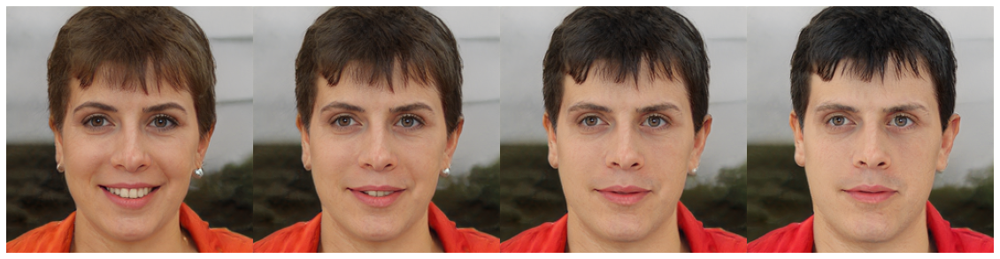

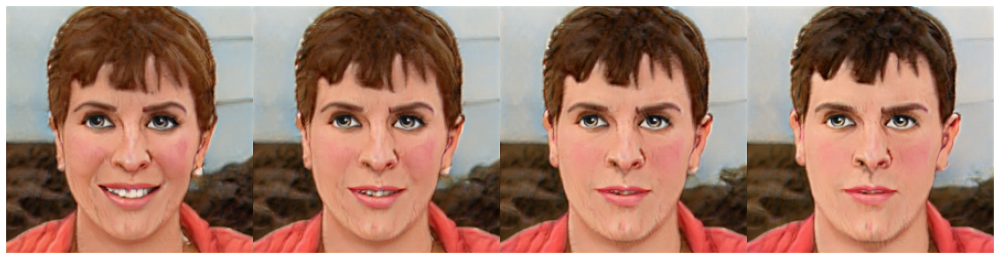

In [34]:
import torch

from model import Generator
from utils import imshow, tensor2image

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Generator1
network1='/content/Cartoon-StyleGan2/networks/ffhq256.pt' 
network1 = torch.load(network1)

generator1 = Generator(256, 512, 8, channel_multiplier=2).to(device)
generator1.load_state_dict(network1["g_ema"], strict=False)

trunc1 = generator1.mean_latent(4096)

# Generator2
Target_network = "Disney_FreezeSG" #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
network2=f'/content/Cartoon-StyleGan2/networks/{Target_network}.pt' 
network2 = torch.load(network2)

generator2 = Generator(256, 512, 8, channel_multiplier=2).to(device)
generator2.load_state_dict(network2["g_ema"], strict=False)

trunc2 = generator2.mean_latent(4096)

# ---------------
# Interpolation
# ---------------

number_of_step = 4 #@param {type:"slider", min:0, max:30, step:1}
latent_interp = torch.zeros(number_of_step, latent_init1.shape[1], latent_init1.shape[2]).to(device)
strength = 2.25 #@param {type:"slider", min:1, max:3, step:0.25}
swap = True #@param {type:"boolean"}
swap_layer_num = 4 #@param {type:"slider", min:1, max:6, step:1}


with torch.no_grad():
    for j in range(number_of_step):

        latent_interp[j] = latent_init1 + strength * (latent_fin1-latent_init1) * float(j/(number_of_step-1))

        imgs_gen1, save_swap_layer = generator1([latent_interp],
                                input_is_latent=True,                                     
                                truncation=0.7,
                                truncation_latent=trunc1,
                                swap=swap, swap_layer_num=swap_layer_num,
                                randomize_noise=False)
        imgs_gen2, _ = generator2([latent_interp],
                                input_is_latent=True,                                     
                                truncation=0.7,
                                swap=swap, swap_layer_num=swap_layer_num, swap_layer_tensor=save_swap_layer,
                                truncation_latent=trunc2)

imshow(tensor2image(torch.cat([img_gen for img_gen in imgs_gen1], dim=2)), 20)
imshow(tensor2image(torch.cat([img_gen for img_gen in imgs_gen2], dim=2)), 20)

## 4-2 [실험2] StyleCLIP 파라미터 및 설정값 입력

> ✔ description에 goal을 상세하게 입력하면 g1을 통해 생성한 latent face를 description에 맞게 style transfer를 수행함

> ✔ 저해상도 레이어를 수정한 버전

In [37]:
seed = 356289 #@param {type:"slider", min:0, max:1000000, step:1}

description = 'The image of a man with long black hair' #@param {type:"string"}

latent_path = None #@param {type:"string"}

optimization_steps = 300 #@param {type:"number"}

l2_lambda = 0.004 #@param {type:"number"}

create_video = False #@param {type:"boolean"}

result_dir = "asset/results2" #@param {type:"string"}

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

args = {
    "seed" : seed,
    "description": description,
    "ckpt": "/content/Cartoon-StyleGan2/networks/ffhq256.pt",
    "ckpt2": "/content/Cartoon-StyleGan2/networks/NaverWebtoon.pt",
    "stylegan_size": 256,
    "latent_dim" : 14,
    "lr_rampup": 0.05,
    "lr": 0.1,
    "step": optimization_steps,
    "l2_lambda": l2_lambda,
    "latent_path": latent_path,
    "truncation": 0.7,
    "save_intermediate_image_every": 1 if create_video else 20,
    "device" : "cuda",
    "results_dir": result_dir,
}

from run_optimization import main
from argparse import Namespace

final_result, latent_init2, latent_fin2 = main(Namespace(**args))

  0%|          | 0/300 [00:00<?, ?it/s]/content/Cartoon-StyleGan2/op/conv2d_gradfix.py:89: UserWarning: conv2d_gradfix not supported on PyTorch 1.9.0+cu102. Falling back to torch.nn.functional.conv2d().
  f"conv2d_gradfix not supported on PyTorch {torch.__version__}. Falling back to torch.nn.functional.conv2d()."
loss: 0.8345;:   0%|          | 0/300 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)
loss: 0.7598;: 100%|██████████| 300/300 [00:38<00:00,  7.80it/s]


/content/Cartoon-StyleGan2/op/conv2d_gradfix.py:89: UserWarning: conv2d_gradfix not supported on PyTorch 1.9.0+cu102. Falling back to torch.nn.functional.conv2d().
  f"conv2d_gradfix not supported on PyTorch {torch.__version__}. Falling back to torch.nn.functional.conv2d()."


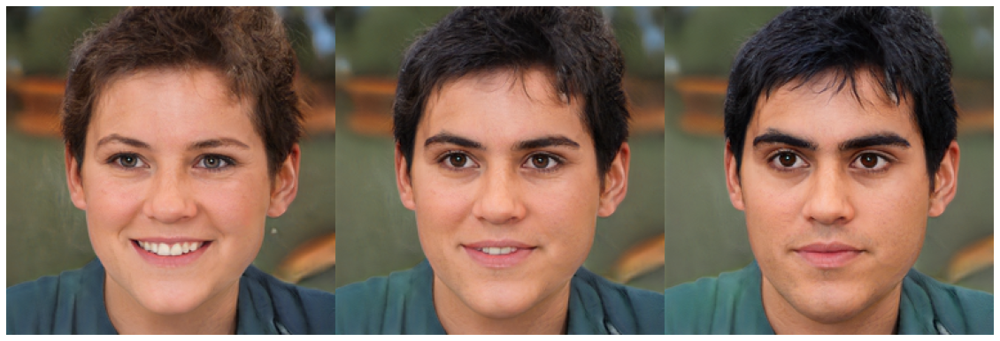

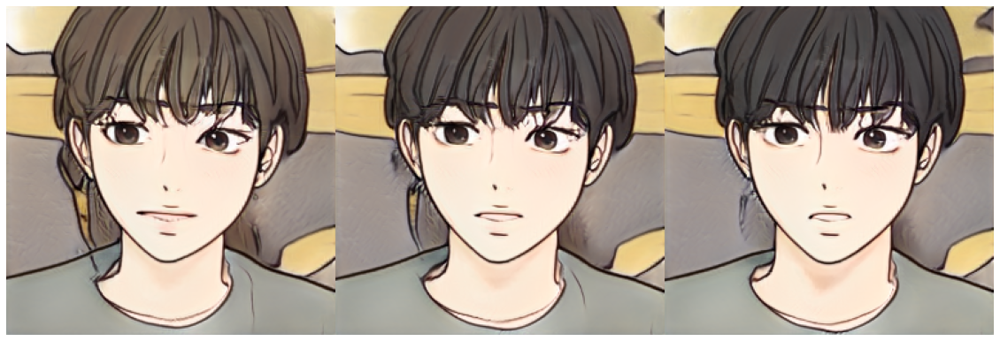

In [39]:
import torch

from model import Generator
from utils import imshow, tensor2image

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Generator1
network1='/content/Cartoon-StyleGan2/networks/ffhq256.pt' 
network1 = torch.load(network1)

generator1 = Generator(256, 512, 8, channel_multiplier=2).to(device)
generator1.load_state_dict(network1["g_ema"], strict=False)

trunc1 = generator1.mean_latent(4096)

# Generator2
Target_network = "NaverWebtoon_FreezeSG" #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
network2=f'/content/Cartoon-StyleGan2/networks/{Target_network}.pt' 
network2 = torch.load(network2)

generator2 = Generator(256, 512, 8, channel_multiplier=2).to(device)
generator2.load_state_dict(network2["g_ema"], strict=False)

trunc2 = generator2.mean_latent(4096)

# ---------------
# Interpolation
# ---------------

number_of_step = 3 #@param {type:"slider", min:0, max:10, step:1}
latent_interp = torch.zeros(number_of_step, latent_init2.shape[1], latent_init2.shape[2]).to(device)

strength = 2.5 #@param {type:"slider", min:1, max:3, step:0.25}
swap = True #@param {type:"boolean"}
swap_layer_num = 2 #@param {type:"slider", min:1, max:6, step:1}


with torch.no_grad():
    for j in range(number_of_step):

        latent_interp[j] = latent_init2 + strength * (latent_fin2-latent_init2) * float(j/(number_of_step-1))

        imgs_gen1, save_swap_layer = generator1([latent_interp],
                                input_is_latent=True,                                     
                                truncation=0.7,
                                truncation_latent=trunc1,
                                swap=swap, swap_layer_num=swap_layer_num,
                                randomize_noise=False)
        imgs_gen2, _ = generator2([latent_interp],
                                input_is_latent=True,                                     
                                truncation=0.7,
                                swap=swap, swap_layer_num=swap_layer_num, swap_layer_tensor=save_swap_layer,
                                truncation_latent=trunc2)
        
imshow(tensor2image(torch.cat([img_gen for img_gen in imgs_gen1], dim=2)), 20)
imshow(tensor2image(torch.cat([img_gen for img_gen in imgs_gen2], dim=2)), 20)

## 4-2 [실험3] 이미지를 업로드하여 변경 수행

> ✔ files.upload()를 통한 이미지 파일 업로드

> ✔ im.resize() 부분은 추후 수정해야 할듯 보임


In [3]:
from google.colab import files
uploaded = files.upload()
image_name = list(uploaded.keys())[0]
image_name = image_name.split('.')


from PIL import Image
im = Image.open(f"/content/Cartoon-StyleGan2/{image_name[0]}.jpg")
im = im.resize((256,256))

im.save(f"/content/Cartoon-StyleGan2/{image_name[0]}.jpg")

Saving iu.jpg to iu.jpg


In [56]:
import gc
import torch

gc.collect()
torch.cuda.empty_cache()

In [ ]:
!echo {image_name[0]}
!python projector.py --ckpt=/content/Cartoon-StyleGan2/networks/ffhq256.pt --factor='networks/factor' --e_ckpt=/content/Cartoon-StyleGan2/networks/encoder_ffhq.pt \
                            --files=/content/Cartoon-StyleGan2/{image_name[0]}.jpg

In [5]:
import torch

project = torch.load("/content/Cartoon-StyleGan2/project.pt")
project_result = project[image_name[0]]['latent']
torch.save(project_result, '/content/Cartoon-StyleGan2/latent.pt')

project = torch.load('/content/Cartoon-StyleGan2/latent.pt').cuda()

In [6]:
seed = 357918 #@param {type:"slider", min:0, max:1000000, step:1}

target_network = 'Romance101' #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
description = 'face with black hair' #@param {type:"string"}

latent_path = "/content/Cartoon-StyleGan2/latent.pt" #@param {type:"string"}

optimization_steps = 300 #@param {type:"number"}

l2_lambda = 0.004 #@param {type:"number"}

create_video = False #@param {type:"boolean"}

result_dir = "asset/results3" #@param {type:"string"}

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# -----------------------------
args = {
    "seed" : seed,
    "description": description,
    "ckpt": "/content/Cartoon-StyleGan2/networks/ffhq256.pt",
    "ckpt2": f"/content/Cartoon-StyleGan2/networks/{target_network}.pt",
    "stylegan_size": 256,
    "latent_dim" : 14,
    "lr_rampup": 0.05,
    "lr": 0.1,
    "step": optimization_steps,
    "l2_lambda": l2_lambda,
    "latent_path": latent_path,
    "truncation": 0.7,
    "save_intermediate_image_every": 1 if create_video else 20,
    "device" : "cuda",
    "results_dir": result_dir,
}

# -----------------------------

from run_optimization import main
from argparse import Namespace

final_result, latent_init3, latent_fin3 = main(Namespace(**args))


100%|███████████████████████████████████████| 338M/338M [00:05<00:00, 62.1MiB/s]
  0%|          | 0/300 [00:00<?, ?it/s]/content/Cartoon-StyleGan2/op/conv2d_gradfix.py:89: UserWarning: conv2d_gradfix not supported on PyTorch 1.9.0+cu102. Falling back to torch.nn.functional.conv2d().
  f"conv2d_gradfix not supported on PyTorch {torch.__version__}. Falling back to torch.nn.functional.conv2d()."
loss: 0.7437;:   0%|          | 0/300 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torchvision/utils.py:50: UserWarning: range will be deprecated, please use value_range instead.
  warnings.warn(warning)
loss: 0.7168;: 100%|██████████| 300/300 [00:46<00:00,  6.40it/s]


/content/Cartoon-StyleGan2/op/conv2d_gradfix.py:89: UserWarning: conv2d_gradfix not supported on PyTorch 1.9.0+cu102. Falling back to torch.nn.functional.conv2d().
  f"conv2d_gradfix not supported on PyTorch {torch.__version__}. Falling back to torch.nn.functional.conv2d()."


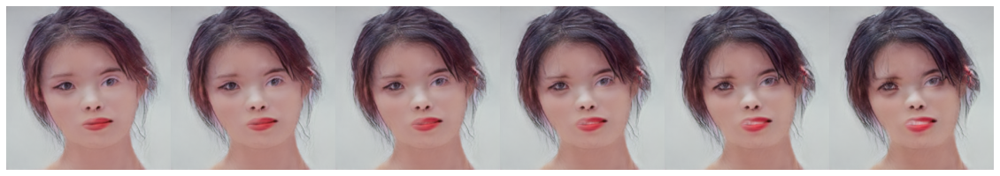

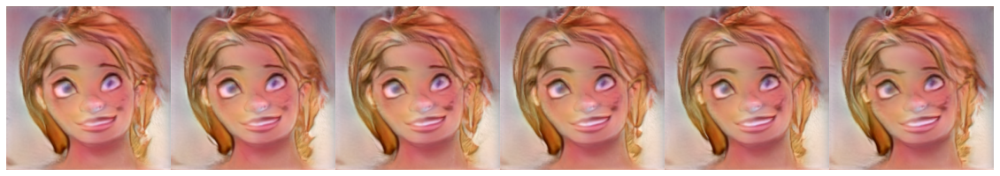

In [11]:
import torch

from model import Generator
from utils import imshow, tensor2image

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ---------------
# Generator
# ---------------

# Generator1
network1='/content/Cartoon-StyleGan2/networks/ffhq256.pt' 
network1 = torch.load(network1)

generator1 = Generator(256, 512, 8, channel_multiplier=2).to(device)
generator1.load_state_dict(network1["g_ema"], strict=False)

trunc1 = generator1.mean_latent(4096)

# Generator2
Target_network = "Disney" #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
network2=f'/content/Cartoon-StyleGan2/networks/{Target_network}.pt' 
network2 = torch.load(network2)

generator2 = Generator(256, 512, 8, channel_multiplier=2).to(device)
generator2.load_state_dict(network2["g_ema"], strict=False)

trunc2 = generator2.mean_latent(4096)

# ---------------
# Interpolation
# ---------------

number_of_step = 6 #@param {type:"slider", min:0, max:10, step:1}
latent_interp = torch.zeros(number_of_step, latent_init3.shape[1], latent_init3.shape[2]).to(device)

sample_z_style = torch.randn(number_of_step, 512, device=device)
strength = 1.5 #@param {type:"slider", min:1, max:5, step:0.5}
swap = True #@param {type:"boolean"}
swap_layer_num = 2 #@param {type:"slider", min:1, max:6, step:1}

with torch.no_grad():
    for j in range(number_of_step):

        latent_interp[j] = latent_init3 + strength * (latent_fin3-latent_init3) * float(j/(number_of_step-1))
        
        imgs_gen1, save_swap_layer = generator1([latent_interp],
                                input_is_latent=True,                                     
                                truncation=0.7,
                                truncation_latent=trunc1,
                                swap=swap, swap_layer_num=swap_layer_num,
                                randomize_noise=False)
        imgs_gen2, _ = generator2([latent_interp],
                                input_is_latent=True,                                     
                                truncation=0.7,
                                truncation_latent=trunc2,
                                swap=swap, swap_layer_num=swap_layer_num, swap_layer_tensor=save_swap_layer,
                                randomize_noise=True,
                                )
imshow(tensor2image(torch.cat([img_gen for img_gen in imgs_gen1], dim=2)), 20)
imshow(tensor2image(torch.cat([img_gen for img_gen in imgs_gen2], dim=2)), 20)

/content/Cartoon-StyleGan2/op/conv2d_gradfix.py:89: UserWarning: conv2d_gradfix not supported on PyTorch 1.9.0+cu102. Falling back to torch.nn.functional.conv2d().
  f"conv2d_gradfix not supported on PyTorch {torch.__version__}. Falling back to torch.nn.functional.conv2d()."


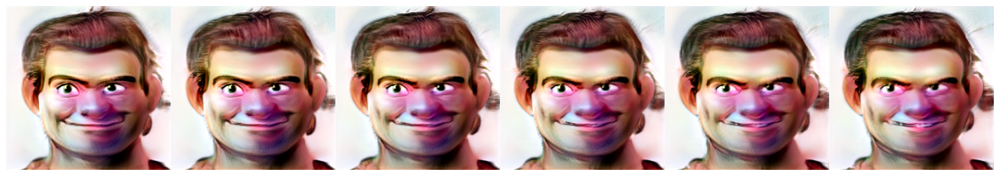

In [45]:
import torch

from model import Generator
from utils import imshow, tensor2image

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

Target_network = "Disney" #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
network=f'/content/Cartoon-StyleGan2/networks/{Target_network}.pt' 
network = torch.load(network)

generator = Generator(256, 512, 8, channel_multiplier=2).to(device)
generator.load_state_dict(network["g_ema"], strict=False)

trunc = generator.mean_latent(4096)

number_of_step = 6 #@param {type:"slider", min:0, max:10, step:1}
latent_interp = torch.zeros(number_of_step, latent_init3.shape[1], latent_init3.shape[2]).to(device)

sample_z_style = torch.randn(number_of_step, 512, device=device)
strength = 3.5 #@param {type:"slider", min:1, max:5, step:0.5}
swap = True #@param {type:"boolean"}
swap_layer_num = 2 #@param {type:"slider", min:1, max:6, step:1}

with torch.no_grad():
    for j in range(number_of_step):

        latent_interp[j] = latent_init3 + strength * (latent_fin3-latent_init3) * float(j/(number_of_step-1))
        imgs_gen2, _ = generator2([latent_interp],
                                input_is_latent=True,                                     
                                truncation=0.7,
                                truncation_latent=trunc2,
                                swap=swap, swap_layer_num=swap_layer_num, swap_layer_tensor=save_swap_layer,
                                randomize_noise=True,
                                )
imshow(tensor2image(torch.cat([img_gen for img_gen in imgs_gen2], dim=2)), 20)

## 3. Style Mixing

Inspired by style mixing, I mixed style vectors of two images. Just mixing two different images with different feelings creates a high-quality image.

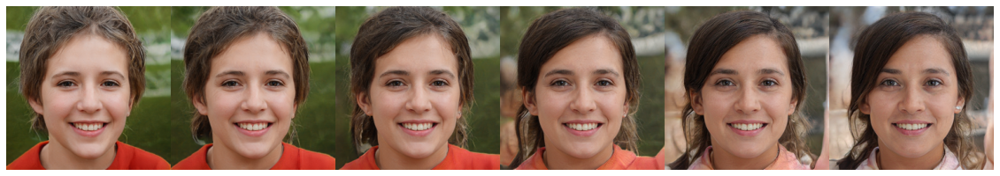

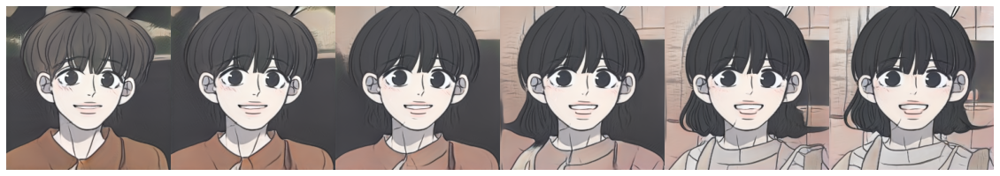

In [ ]:
#@title { display-mode: "form", run: "auto"}


import torch

from model import Generator
from utils import imshow, tensor2image

device = 'cuda'
Target_network = "Romance101" #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
swap = False #@param {type:"boolean"}
save_swap_layer = 1 #@param {type:"slider", min:1, max:6, step:1}

# ---------------
# Generator
# ---------------

# Generator1
network1='/content/Cartoon-StyleGan2/networks/ffhq256.pt' 
network1 = torch.load(network1)

generator1 = Generator(256, 512, 8, channel_multiplier=2).to(device)
generator1.load_state_dict(network1["g_ema"], strict=False)

trunc1 = generator1.mean_latent(4096)

# latent1
seed1 = 627356 #@param {type:"slider", min:0, max:1000000, step:1}
torch.manual_seed(seed1)
latent1 = torch.randn(1, 14, 512, device=device)
latent1 = generator1.get_latent(latent1)


# Generator2
network2=f'/content/Cartoon-StyleGan2/networks/{Target_network}.pt' 
network2 = torch.load(network2)

generator2 = Generator(256, 512, 8, channel_multiplier=2).to(device)
generator2.load_state_dict(network2["g_ema"], strict=False)

trunc2 = generator2.mean_latent(4096)

# latent2
seed2 = 159972 #@param {type:"slider", min:0, max:1000000, step:1}
torch.manual_seed(seed2)
latent2 = torch.randn(1, 14, 512, device=device)
latent2 = generator2.get_latent(latent2)

# ---------------
# Interpolation
# ---------------

number_of_step = 6 #@param {type:"slider", min:0, max:10, step:1}
latent_interp = torch.zeros(number_of_step, latent1.shape[1], latent1.shape[2]).to(device)

with torch.no_grad():
    for j in range(number_of_step):

        latent_interp[j] = latent1 + (latent2-latent1) * float(j/(number_of_step-1))

        imgs_gen1, save_extract_layer = generator1([latent_interp],
                                input_is_latent=True,                                     
                                truncation=0.7,
                                truncation_latent=trunc1,
                                swap=swap, swap_layer_num=swap_layer_num,
                                )
                                
        imgs_gen2, _ = generator2([latent_interp],
                                input_is_latent=True,                                     
                                truncation=0.7,
                                truncation_latent=trunc2,
                                swap=swap, swap_layer_num=swap_layer_num, swap_layer_tensor=save_swap_layer,
                                )

imshow(tensor2image(torch.cat([img_gen for img_gen in imgs_gen1], dim=2)), 20)
imshow(tensor2image(torch.cat([img_gen for img_gen in imgs_gen2], dim=2)), 20)

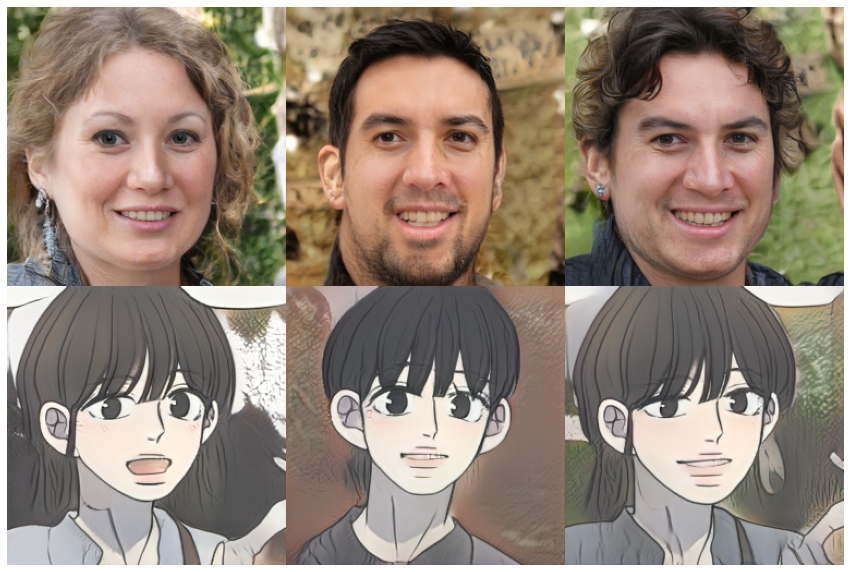

In [ ]:
from utils import imshow, tensor2image

device = 'cuda'
truncation = 0.7 

target_network ="Romance101" #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
swap = False #@param {type:"boolean"}
swap_layer_num = 1 #@param {type:"slider", min:1, max:6, step:1}
# ----------------------
# Source Images (FFHQ)
# ----------------------

network1='/content/Cartoon-StyleGan2/networks/ffhq256.pt' 
network1 = torch.load(network1)

# Genearator1
g1 = Generator(256, 512, 8, channel_multiplier=2).to(device)
g1.load_state_dict(network1["g"], strict=False)
trunc1 = g1.mean_latent(4096)

# latent1
seed1 = 124322 #@param {type:"slider", min:0, max:1000000, step:1}
torch.manual_seed(seed1)
r_latent1 = torch.randn(1, 14, 512, device=device)
latent1 = g1.get_latent(r_latent1)

# latent2
seed2 = 398781 #@param {type:"slider", min:0, max:1000000, step:1}
torch.manual_seed(seed2)
r_latent2 = torch.randn(1, 14, 512, device=device)
latent2 = g1.get_latent(r_latent2)

# latent mixing
latent_mixing1 = 4 #@param {type:"slider", min:0, max:15, step:1}
latent_mixing2 = 9 #@param {type:"slider", min:0, max:15, step:1}

latent3 = torch.cat([latent1[:,:latent_mixing1,:], latent2[:,latent_mixing1:latent_mixing2,:], latent1[:,latent_mixing2:,:]], dim = 1)
# latent4 = torch.cat([latent1[:,:,:latent_mixing2], latent2[:,:,latent_mixing2:]], dim = 2)

# Latent !
latent = torch.cat([latent1, latent2, latent3], dim = 0)

# generate image
img1, save_swap_layer = g1(
    [latent],
    truncation=truncation,
    truncation_latent=trunc1,
    swap=swap, swap_layer_num=swap_layer_num,
    input_is_latent=True,
)

# =================================================

# ----------------------
# Target Images (Cartoon)
# ----------------------


network2 =f'/content/Cartoon-StyleGan2/networks/{target_network}.pt'
network2 = torch.load(network2)

# Genearator2
g2 = Generator(256, 512, 8, channel_multiplier=2).to(device)
g2.load_state_dict(network2["g"], strict=False)
trunc2 = g2.mean_latent(4096)

# generate image

img2, _ = g2(
    [latent],
    input_is_latent=True,
    truncation=truncation,
    truncation_latent=trunc2,
    swap=swap, swap_layer_num=swap_layer_num, swap_layer_tensor=save_swap_layer,
)

# =================================================

# Show Image

ffhq = torch.cat([img1[0], img1[1], img1[2]], dim=2)
cartoon = torch.cat([img2[0], img2[1], img2[2]], dim=2)

imshow(tensor2image(torch.cat([ffhq, cartoon], dim = 1)), 15)

### Make A Video 📹

In [ ]:
#@title  { run: "auto" }

# Save Image
import torch
import os
from utils import make_image
from torchvision.utils import save_image, make_grid
import PIL.Image as pilimg
from model import Generator

device = 'cuda'
truncation = 0.7 

target_network = 'Romance101' #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']

# ----------------------
# Source Images (FFHQ)
# ----------------------


network1='/content/Cartoon-StyleGan2/networks/ffhq256.pt' 
network1 = torch.load(network1)

# Genearator1
g1 = Generator(256, 512, 8, channel_multiplier=2).to(device)
g1.load_state_dict(network1["g"], strict=False)
trunc1 = g1.mean_latent(4096)

# latent1
seed1 = 627356 #@param {type:"slider", min:0, max:1000000, step:1}
torch.manual_seed(seed1)
r_latent1 = torch.randn(1, 14, 512, device=device)
latent1 = g1.get_latent(r_latent1)

# latent2
seed2 = 159972 #@param {type:"slider", min:0, max:1000000, step:1}
torch.manual_seed(seed2)
r_latent2 = torch.randn(1, 14, 512, device=device)
latent2 = g1.get_latent(r_latent2)

# latent mixing
latent_mixing1 = 1 #@param {type:"slider", min:0, max:14, step:1}
latent_mixing2 = 419 #@param {type:"slider", min:0, max:512, step:1}

latent3 = torch.cat([latent1[:,:latent_mixing1,:], latent2[:,latent_mixing1:,:]], dim = 1)
latent4 = torch.cat([latent1[:,:,:latent_mixing2], latent2[:,:,latent_mixing2:]], dim = 2)

# Latent !
latent = torch.cat([latent1, latent2, latent3, latent4], dim = 0)


# ----------------------
# Target Images (Cartoon)
# ----------------------

network2=f'/content/Cartoon-StyleGan2/networks/{target_network}.pt'
network2 = torch.load(network2)

# Genearator2
g2 = Generator(256, 512, 8, channel_multiplier=2).to(device)
g2.load_state_dict(network2["g"], strict=False)
trunc2 = g2.mean_latent(4096)




In [ ]:
#@markdown Latent Mixing1

if not os.path.isdir('./asset/latent_mix1'):
   os.makedirs('./asset/latent_mix1', exist_ok=True)

for latent_mixing1 in range(15):
    latent3 = torch.cat([latent1[:,:latent_mixing1,:], latent2[:,latent_mixing1:,:]], dim = 1)
    
    latent = torch.cat([latent2, latent1, latent3], dim = 0)

    img1, mix_layer = g1(
        [latent],
        input_is_latent=True,
        truncation=truncation,
        truncation_latent=trunc1,
        extract_layer=True, extract_layer_num=1,
    )
    img2, _ = g2(
        [latent],
        input_is_latent=True,
        truncation=truncation,
        truncation_latent=trunc2,
        extract_layer=False, extract_layer_num=1, put_layer = mix_layer,
    )

    img_name = "/content/Cartoon-StyleGan2/asset/latent_mix1/latent_mixing1_" + str(latent_mixing1) + ".png"
    grid = make_grid(torch.cat([img1, img2], dim=0),
                    nrow=3,
                    normalize=True,
                    range=(-1,1))

    ndarr = grid.mul(255).add_(0.5).clamp_(0, 255).permute(1, 2, 0).to('cpu', torch.uint8).numpy()
    im = pilimg.fromarray(ndarr)
    im.save(img_name)



In [ ]:
#@title  { run: "auto" }


# =====================================

from PIL import Image
import cv2 
from torchvision.utils import save_image
import PIL.Image as pilimg
import numpy as np

img_name = "/content/Cartoon-StyleGan2/asset/latent_mix1/latent_mixing1_0.png"
image = Image.open(img_name)

frameSize = image.size
FPS = 3 #@param {type:"slider", min:0, max:10, step:1}
fourcc = cv2.VideoWriter_fourcc(*'XVID')

video = cv2.VideoWriter('/content/Cartoon-StyleGan2/asset/latent_mix1/latent_mixing1.mp4', fourcc, float(FPS), frameSize)

for i in range(15):

    im = pilimg.open("/content/Cartoon-StyleGan2/asset/latent_mix1/latent_mixing1_" + str(i) + ".png")
    np_img = np.asarray(im)

    frame = cv2.cvtColor(np_img, cv2.COLOR_RGB2BGR)
    video.write(frame)

video.release()
#--------------------------
# Show a Interpolation Video in Colab
#--------------------------

from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/Cartoon-StyleGan2/asset/latent_mix1/latent_mixing1.mp4','rb').read()

data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=700 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
#@markdown Latent Mixing2

if not os.path.isdir('./asset/latent_mix2'):
   os.makedirs('./asset/latent_mix2', exist_ok=True)

for latent_mixing2 in range(64):
    latent3 = torch.cat([latent1[:,:,:latent_mixing2*8], latent2[:,:,latent_mixing2*8:]], dim = 2)
    
    latent = torch.cat([latent2, latent1, latent3], dim = 0)

    img1, mix_layer = g1(
        [latent],
        input_is_latent=True,
        truncation=truncation,
        truncation_latent=trunc1,
        extract_layer=True, extract_layer_num=1,
    )
    img2, _ = g2(
        [latent],
        input_is_latent=True,
        truncation=truncation,
        truncation_latent=trunc2,
        extract_layer=False, extract_layer_num=1, put_layer = mix_layer,
    )

    img_name = "/content/Cartoon-StyleGan2/asset/latent_mix2/latent_mixing2_" + str(latent_mixing2) + ".png"
    grid = make_grid(torch.cat([img1, img2], dim=0),
                    nrow=3,
                    normalize=True,
                    range=(-1,1))

    ndarr = grid.mul(255).add_(0.5).clamp_(0, 255).permute(1, 2, 0).to('cpu', torch.uint8).numpy()
    im = pilimg.fromarray(ndarr)
    im.save(img_name)



In [ ]:
#@title  { run: "auto" }


# =====================================

from PIL import Image
import cv2 
from torchvision.utils import save_image
import PIL.Image as pilimg
import numpy as np

img_name = "/content/Cartoon-StyleGan2/asset/latent_mix2/latent_mixing2_0.png"
image = Image.open(img_name)

frameSize = image.size
FPS = 15 #@param {type:"slider", min:0, max:50, step:1}
fourcc = cv2.VideoWriter_fourcc(*'XVID')

video = cv2.VideoWriter('/content/Cartoon-StyleGan2/asset/latent_mix2/latent_mixing2.mp4', fourcc, float(FPS), frameSize)

for i in range(64):

    im = pilimg.open("/content/Cartoon-StyleGan2/asset/latent_mix2/latent_mixing2_" + str(i) + ".png")
    np_img = np.asarray(im)

    frame = cv2.cvtColor(np_img, cv2.COLOR_RGB2BGR)
    video.write(frame)

video.release()
#--------------------------
# Show a Interpolation Video in Colab
#--------------------------

from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/Cartoon-StyleGan2/asset/latent_mix2/latent_mixing2.mp4','rb').read()

data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=700 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

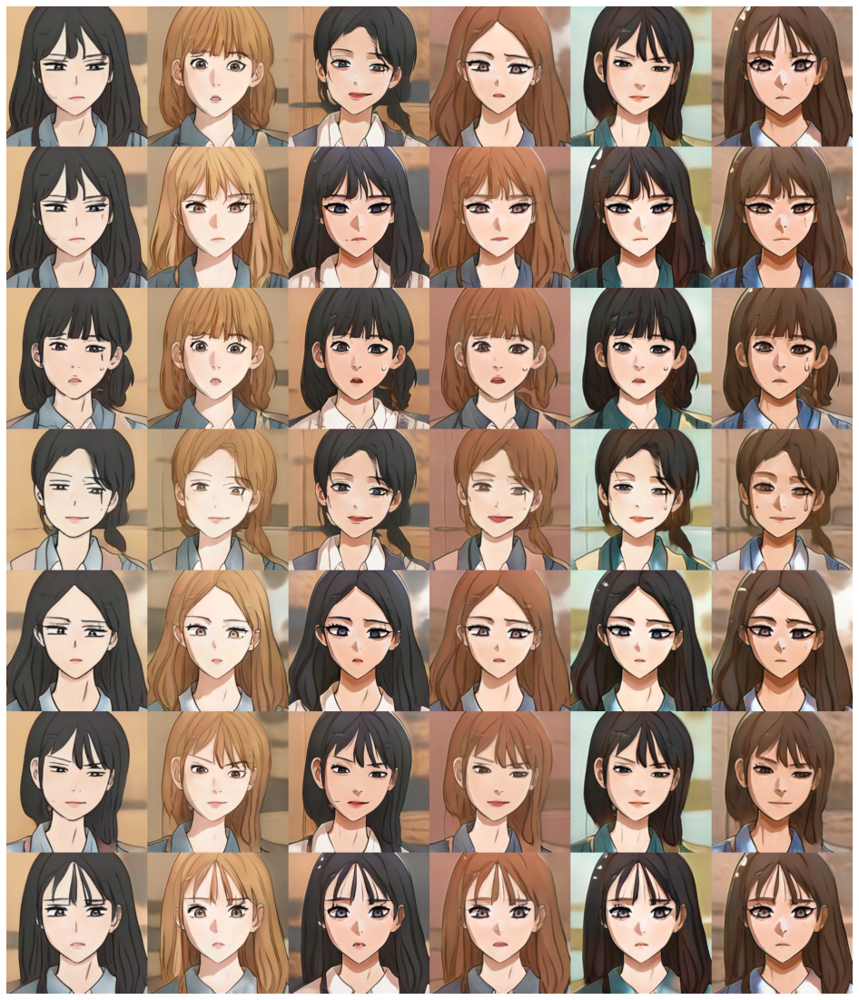

In [ ]:
from utils import imshow, tensor2image

device = 'cuda'
truncation = 0.7 

save_latent = False #@param {type:"boolean"}
target_network ="NaverWebtoon" #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
n_sample = 6 #@param {type:"slider", min:1, max:10, step:1}
# latent mixing
latent_mixing1 = 6 #@param {type:"slider", min:0, max:14, step:1}


# ----------------------
# Source Images (FFHQ)
# ----------------------

network1=f'/content/Cartoon-StyleGan2/networks/{target_network}.pt' 
network1 = torch.load(network1)

# Genearator1
g1 = Generator(256, 512, 8, channel_multiplier=2).to(device)
g1.load_state_dict(network1["g"], strict=False)
trunc1 = g1.mean_latent(4096)

# latent1
if not save_latent:
  r_latent1 = torch.randn(n_sample, 14, 512, device=device)
  latent1 = g1.get_latent(r_latent1)

# generate image
img1, _ = g1(
    [latent1],
    truncation=truncation,
    truncation_latent=trunc1,
    input_is_latent=True,
)

images = [torch.cat([img for img in img1], 2)]


for i in range(n_sample):
  latent = latent1[i].unsqueeze(0).repeat(n_sample, 1, 1)
  latent2 = torch.cat([latent[:,:latent_mixing1,:], latent1[:,latent_mixing1:,:]], dim = 1)
  
  # generate image
  img1, _ = g1(
      [latent2],
      truncation=truncation,
      truncation_latent=trunc1,
      input_is_latent=True,
  )

  images.append(torch.cat([img for img in img1], 2))

imshow(tensor2image(torch.cat([img for img in images], 1)), 20)

## 4. Closed-Form Factorization

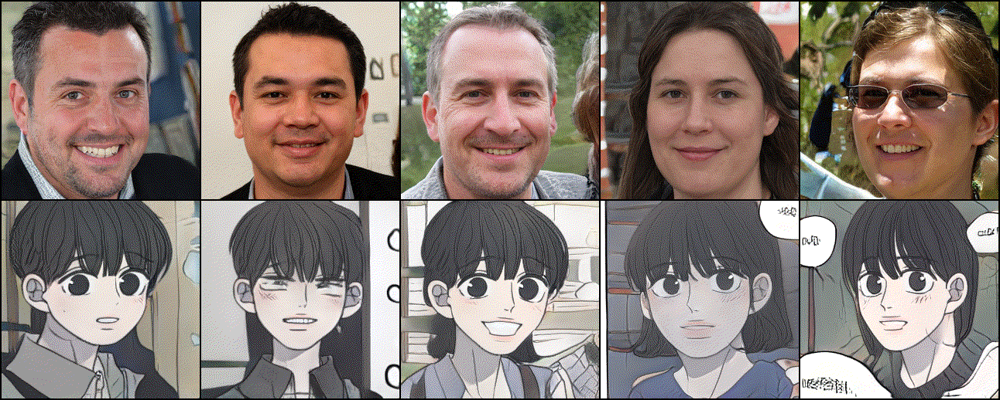

In [ ]:
!python apply_factor.py --index=7 --degree=14 --seed=123177 --n_sample=5 \
                        --ckpt='/content/Cartoon-StyleGan2/networks/ffhq256.pt' --ckpt2='/content/Cartoon-StyleGan2/networks/Romance101.pt' \
                        --factor='/content/Cartoon-StyleGan2/networks/factor.pt' --outdir='asset/results-sefa' --video 

from IPython.display import Image
Image(open('/content/Cartoon-StyleGan2/asset/results-sefa/video.gif','rb').read())

In [ ]:
#@title { display-mode: "form", run: "auto"}

import torch
import cv2 
import numpy as np
from torchvision.utils import save_image, make_grid
import PIL.Image as pilimg

from model import Generator


device='cuda'
n_sample=5
truncation = 0.7
trunc = 0.7

# Eigen-Vector
factor='/content/Cartoon-StyleGan2/factor.pt'
eigvec = torch.load(factor)["eigvec"].to(device)


# =============================================

# Genearaotr1
network1 = 'ffhq256' #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
network1=f'/content/Cartoon-StyleGan2/networks/{network1}.pt' 
network1 = torch.load(network1)

g1 = Generator(256, 512, 8, channel_multiplier=2).to(device)
g1.load_state_dict(network1["g_ema"], strict=False)


# Generator2
network2 = 'TrueBeauty' #@param ['ffhq256', 'NaverWebtoon', 'NaverWebtoon_StructureLoss', 'NaverWebtoon_FreezeSG', 'Romance101', 'TrueBeauty', 'Disney', 'Disney_StructureLoss', 'Disney_FreezeSG', 'Metface_StructureLoss', 'Metface_FreezeSG']
network2=f'/content/Cartoon-StyleGan2/networks/{network2}.pt' 
network2 = torch.load(network2)

g2 = Generator(256, 512, 8, channel_multiplier=2).to(device)
g2.load_state_dict(network2["g_ema"], strict=False)

# latent
seed = 177838 #@param {type:"slider", min:0, max:1000000, step:1}
torch.manual_seed(seed)
latent = torch.randn(n_sample, 14, 512, device=device)
latent = g1.get_latent(latent)

# latent direction & scalar
index=19 #@param {type:"slider", min:0, max:512, step:1}
degree=15 #@param {type:"slider", min:0, max:30, step:1}


# =============================================

# directory to save image
outdir = 'result-sefa' #@param {type:"string"}
if not os.path.isdir(f'{outdir}'):
   os.makedirs(f'./asset/{outdir}', exist_ok=True)

imgs = []

for deg in range(degree):

  direction = 0.5 * deg * eigvec[:, index].unsqueeze(0) #torch.Size([1, 512])

  img1, _ = g1(
      [latent + direction],
      truncation=truncation,
      truncation_latent=trunc,
      input_is_latent=True,
  )

  img2, _ = g2(
      [latent + direction],
      truncation=truncation,
      truncation_latent=trunc,
      input_is_latent=True,
  )


  grid = make_grid(torch.cat([img1, img2], 0),
                   nrow=n_sample,
                   normalize=True,
                   range=(-1,1),
                   )
  ndarr = grid.mul(255).add_(0.5).clamp_(0, 255).permute(1, 2, 0).to('cpu', torch.uint8).numpy()
  im = pilimg.fromarray(ndarr)
  im.save(f'/content/Cartoon-StyleGan2/asset/{outdir}/out-{deg}.png')



In [ ]:
#@title { display-mode: "form", run: "auto"}

# =============================================

# Setting for Video

im = Image.open(f'/content/Cartoon-StyleGan2/asset/{outdir}/out-0.png')
frameSize = im.size
FPS = 10 #@param {type:"slider", min:0, max:60, step:1}
fourcc = cv2.VideoWriter_fourcc(*'XVID')
video_name = "pose" #@param {type:"string"}

video = cv2.VideoWriter(f'/content/Cartoon-StyleGan2/asset/{outdir}/video-seed{seed}-index{index}-{video_name}.mp4', fourcc, float(FPS), frameSize)

for deg in range(degree):
  im = pilimg.open(f'/content/Cartoon-StyleGan2/asset/{outdir}/out-{deg}.png')
  np_img = np.asarray(im)

  frame = cv2.cvtColor(np_img, cv2.COLOR_RGB2BGR)
  video.write(frame)
video.release()

#--------------------------------------
# Show a Interpolation Video in Colab
#--------------------------------------

from IPython.display import HTML
from base64 import b64encode
mp4 = open(f'/content/Cartoon-StyleGan2/asset/{outdir}/video-seed{seed}-index{index}-{video_name}.mp4','rb').read()

data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=900 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

**Thank you to Naver AI Lab and Professor Yoo Seungjoo for providing good classes and NSML credits !**